## Environment set up and import Libraries

In [39]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [40]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
with tf.device(device_name):
  print(device_name.split(":")[1]," running . . . ")

GPU  running . . . 


In [41]:
import tensorflow as tf
import os,sys
import numpy as np
import random

random.seed(1)
np.random.seed(1)
tf.random.set_seed(2)

In [42]:
import os, keras, numpy,tensorflow
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from numpy import *
from numpy.random import *
from keras.datasets.fashion_mnist import load_data
from keras.datasets import mnist
from tensorflow.keras.optimizers import Adam
from keras.models import Model
from keras.layers import *
from tensorflow.keras import initializers

## **Discriminator** Model

In [43]:
def define_discriminator(in_shape=(64,64,3)):

    # input image
    input_image = Input(shape=in_shape)
    # (64, 64, 3)

    conv2d_layer_1 = Conv2D(filters = 16, kernel_size = (3,3), strides = (2,2), padding='same')(input_image)
    conv2d_layer_1 = LeakyReLU(alpha=0.3)(conv2d_layer_1)
    # (32, 32, 16)

    conv2d_layer_2 = Conv2D(filters = 32, kernel_size = (3,3), strides = (2,2), padding = 'same')(conv2d_layer_1)
    conv2d_layer_2 = LeakyReLU(alpha=0.3)(conv2d_layer_2)
    # (16, 16, 32)

    conv2d_layer_3 = Conv2D(filters = 64, kernel_size = (3,3),  strides = (2,2), padding = 'same')(conv2d_layer_2)
    conv2d_layer_3 = LeakyReLU(alpha=0.3)(conv2d_layer_3)
    # (8, 8, 64)

    conv2d_layer_4 = Conv2D(filters = 128, kernel_size = (3,3), strides = (2,2), padding = 'same')(conv2d_layer_3)
    conv2d_layer_4 = LeakyReLU(alpha=0.3)(conv2d_layer_4)
    # (4, 4, 128)

    flatten_layer = Flatten()(conv2d_layer_4)
    # (4 * 4 * 128)

    dropout_layer = Dropout(rate=0.4)(flatten_layer)
    # (4 * 4 * 128)

    dense_layer = Dense(128*8, activation='relu')(dropout_layer)
    # (8 * 128)

    # final layer
    output_layer = Dense(1, activation='sigmoid')(dense_layer)
    # (1,)

    model = Model(input_image, output_layer)

    opt = Adam(learning_rate= 3e-4, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    return model

a = define_discriminator()
a.summary()

Model: "model_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_40 (Conv2D)          (None, 32, 32, 16)        448       
                                                                 
 leaky_re_lu_34 (LeakyReLU)  (None, 32, 32, 16)        0         
                                                                 
 conv2d_41 (Conv2D)          (None, 16, 16, 32)        4640      
                                                                 
 leaky_re_lu_35 (LeakyReLU)  (None, 16, 16, 32)        0         
                                                                 
 conv2d_42 (Conv2D)          (None, 8, 8, 64)          18496     
                                                                 
 leaky_re_lu_36 (LeakyReLU)  (None, 8, 8, 64)          0  

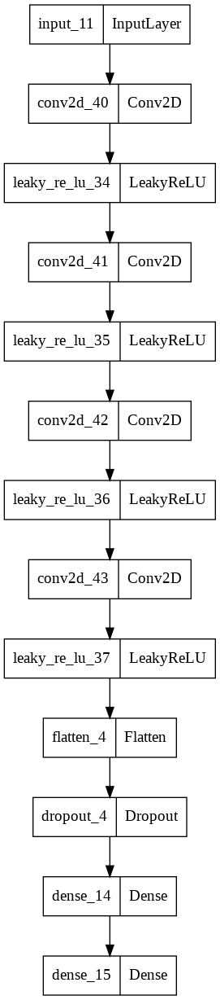

In [44]:
# plot the discriminator model
tf.keras.utils.plot_model(a)

## **Generator** Model

In [45]:
def define_generator(latent_dim = 100):

    # latent input
    latent_layer = Input(shape=(latent_dim,))

    layer_2 = Dense(128 * 8 * 8)(latent_layer)
    layer_2 = Activation("relu")(layer_2)
    layer_2 = Reshape((8, 8, 128))(layer_2)
    layer_2 = BatchNormalization(momentum = 0.8)(layer_2)


    # (8, 8, 128)

    layer_3 = Conv2DTranspose(filters = 128, kernel_size = (3,3), strides=(2,2), padding='same')(layer_2)
    layer_3 = Conv2D(filters = 128, kernel_size = (3,3), padding='same', kernel_initializer = initializers.RandomNormal(0,0.8))(layer_3)
    layer_3 = BatchNormalization(momentum = 0.8)(layer_3)
    layer_3 = LeakyReLU(alpha=0.4)(layer_3)
    # (16, 16, 128)

    layer_4 = Conv2DTranspose(filters = 128, kernel_size = (3,3), strides=(2,2), padding='same')(layer_3)
    layer_4 = Conv2D(filters = 128, kernel_size = (3,3), padding='same',kernel_initializer = initializers.RandomNormal(0,0.8))(layer_4)
    layer_4 = BatchNormalization(momentum = 0.8)(layer_4)
    layer_4 = LeakyReLU(alpha=0.4)(layer_4)
    # (32, 32, 128)

    layer_5 = Conv2DTranspose(filters = 256, kernel_size = (3,3), strides=(2,2), padding='same')(layer_4)
    layer_5 = Conv2D(filters = 256, kernel_size = (3,3), padding='same',kernel_initializer = initializers.RandomNormal(0,0.8))(layer_5)
    layer_5 = BatchNormalization(momentum = 0.8)(layer_5)
    layer_5 = LeakyReLU(alpha=0.4)(layer_5)
    # (64, 64, 128)

    # final layer
    output_layer = Conv2D(filters = 3, kernel_size = (3,3), strides=(1,1), activation='tanh', padding='same')(layer_5)

    model = Model(latent_layer, output_layer)
    return model

b = define_generator(100)
b.summary()

Model: "model_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 100)]             0         
                                                                 
 dense_16 (Dense)            (None, 8192)              827392    
                                                                 
 activation_6 (Activation)   (None, 8192)              0         
                                                                 
 reshape_6 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 batch_normalization_24 (Bat  (None, 8, 8, 128)        512       
 chNormalization)                                                
                                                                 
 conv2d_transpose_18 (Conv2D  (None, 16, 16, 128)      147584    
 Transpose)                                               

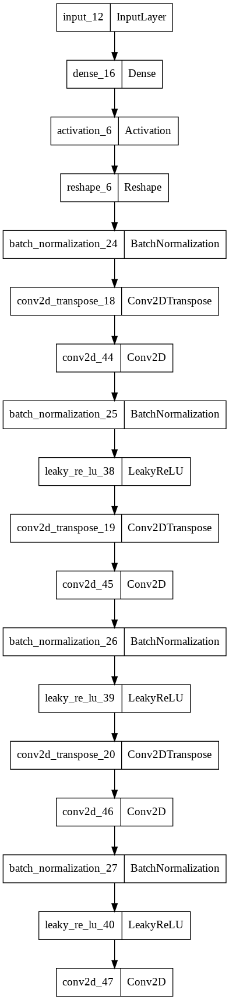

In [46]:
# plot the generator model
tf.keras.utils.plot_model(b)

## **Combine** or **GAN** Model

In [47]:
def define_gan(g_model, d_model):

  d_model.trainable = False

  g_noise = g_model.input
  g_output = g_model.output

  d_output = d_model(g_output)

  model = Model(g_noise, d_output)

  opt = Adam(learning_rate= 3e-4, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt,  metrics=['accuracy'])
  
  return model
c = define_gan(b, a)
c.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 100)]             0         
                                                                 
 dense_16 (Dense)            (None, 8192)              827392    
                                                                 
 activation_6 (Activation)   (None, 8192)              0         
                                                                 
 reshape_6 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 batch_normalization_24 (Bat  (None, 8, 8, 128)        512       
 chNormalization)                                                
                                                                 
 conv2d_transpose_18 (Conv2D  (None, 16, 16, 128)      147584    
 Transpose)                                               

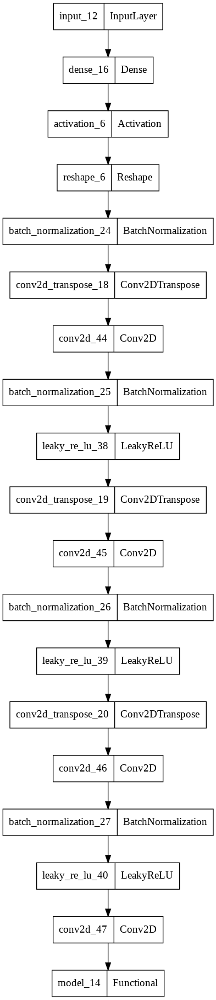

In [48]:
# plot GAN model
tf.keras.utils.plot_model(c)

## Load Dataset

In [49]:
def load_real_samples():
  # load dataset
  data = np.load("/content/drive/MyDrive/Animo/DataSet1/animo_file_10000.npz")
  data = data['a']
  data = np.array(data)
  X = data.astype('float32')
  # scale from [0,255] to [-1,1]
  X = (X - 127.5) / 127.5
  return X
k = load_real_samples()
print("image: ",k.shape)
print("\nshape/size of the first 16 data: ",k[:16].shape)

image:  (10000, 64, 64, 3)

shape/size of the first 16 data:  (16, 64, 64, 3)


## Plot data with label

## Plot data with label

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

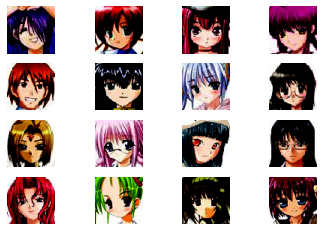

In [50]:
def save_plot(x_input,n=4):
    for i in range(n*n):
        plt.subplot(n, n, i+1)
        plt.imshow(x_input[i,:,:,:])
        plt.axis('off')
    plt.show()
# plot data
save_plot(k[:16])

## Generate real sample function

In [51]:
def generate_real_samples(dataset, n_samples):
	images = dataset
	ix = randint(0, images.shape[0], n_samples)
	X = images[ix]
	y = ones((n_samples, 1))
	return X, y
# d = generate_real_samples(k, 32)
# print("Generate real data as a batch randomly: ",d[0][0].shape)

## Generate latent point function

In [52]:
def generate_latent_points(latent_dim, n_samples, n_classes=2):
  x_input = randn(latent_dim * n_samples)
  z_input = x_input.reshape(n_samples, latent_dim)
  return z_input
# p = generate_latent_points(100, 32)
# print("Generate latent point(with label) as a batch: ",p.shape)

## Generate Fake samples of image with label

In [53]:
def generate_fake_samples(generator, latent_dim, n_samples):
	z_input = generate_latent_points(latent_dim, n_samples)
	images = generator.predict(z_input)
	y = zeros((n_samples, 1))
	return images, y
# with tf.device(device_name):
# 	kh = generate_fake_samples(b, 100, 32)
# 	print("shape of the generated images: ",kh[0].shape)

## Summarize the generator model

In [54]:
def summarize_the_model(generator,latent_dim = 100):
    latent_points = generate_latent_points(latent_dim= latent_dim, n_samples= 16)
    X  = generator.predict(latent_points)
    # scale from [-1,1] to [0,1]
    X = (X + 1) / 2.0
    save_plot(X, n=4)

## Train function

In [55]:
def train(g_model, d_model, gan_model, dataset, latent_dim= 100, n_epochs=3, n_batch=16):

  print("\nNo. of epoch: ",n_epochs)
  bat_per_epo = int(dataset.shape[0] / n_batch)
  print("\nbatch per epoch: ", bat_per_epo)
  half_batch = int(n_batch / 2)
  print("\nfull batch: ", n_batch)
  print("\nhalf batch: ", half_batch,'\n')
  print("*"*50,'\n\n')

  g_loss_array = []
  d_loss_array = []
  for i in range(n_epochs):
    d_loss = 0.0
    g_loss = 0.0
    
    for j in range(bat_per_epo):

      X_real, y_real = generate_real_samples(dataset, half_batch+1)
      X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch+1)
      X_actual_image = np.vstack((X_real,X_fake))
      X_actual_target = np.vstack((y_real,y_fake))
      d_loss_temp = 0.0
      for dk in range(1):
        x,_,y,_ = train_test_split(X_actual_image, X_actual_target, test_size=0.00001, random_state=42)
        d_loss_temp_1, _ = d_model.train_on_batch(x, y)
        d_loss_temp += d_loss_temp_1
      d_loss += (d_loss_temp/1.0)


      z_input = generate_latent_points(latent_dim, n_batch)
      y_gan = ones((n_batch, 1))
      g_loss1,_ = gan_model.train_on_batch(z_input, y_gan)
      g_loss += g_loss1

    d_loss_array.append(d_loss)
    g_loss_array.append(g_loss)

    print('epoch -> [%d/%d], discriminator_loss = %.2f, generator_loss = %.2f\n' %(i+1, n_epochs, d_loss, g_loss))
    summarize_the_model(g_model,latent_dim)
    g_model.save("/content/drive/MyDrive/Animo/DataSet1/generator_model_11.h5")
    np.savez_compressed("/content/drive/MyDrive/Animo/DataSet1/loss_record_11.npz", a=d_loss_array, b=g_loss_array)

    print("\n")

  return d_loss_array, g_loss_array

## Main function


READY TO GO !!!


No. of epoch:  200

batch per epoch:  312

full batch:  32

half batch:  16 

************************************************** 


epoch -> [1/200], discriminator_loss = 169.38, generator_loss = 582.94



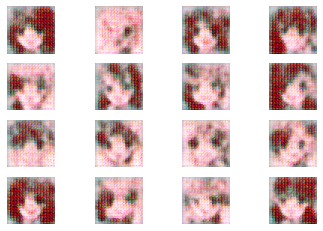



epoch -> [2/200], discriminator_loss = 187.30, generator_loss = 371.06



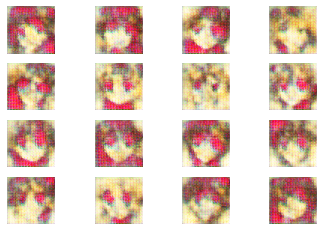



epoch -> [3/200], discriminator_loss = 200.93, generator_loss = 306.25



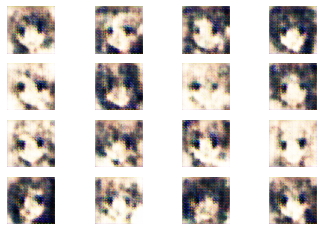



epoch -> [4/200], discriminator_loss = 181.80, generator_loss = 410.66



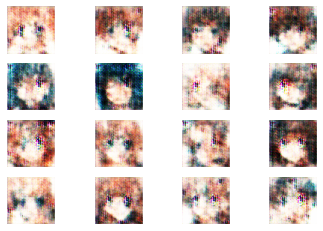



epoch -> [5/200], discriminator_loss = 188.00, generator_loss = 365.25



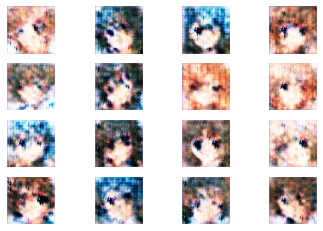



epoch -> [6/200], discriminator_loss = 164.53, generator_loss = 516.26



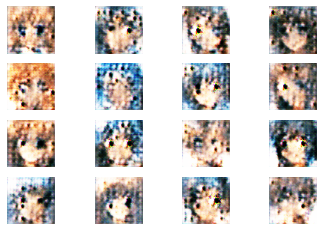



epoch -> [7/200], discriminator_loss = 152.25, generator_loss = 590.39



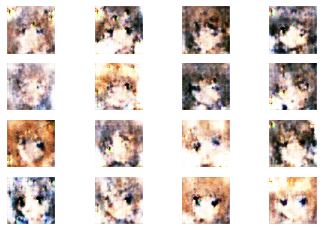



epoch -> [8/200], discriminator_loss = 176.30, generator_loss = 415.41



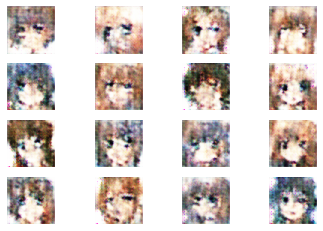



epoch -> [9/200], discriminator_loss = 186.57, generator_loss = 338.27



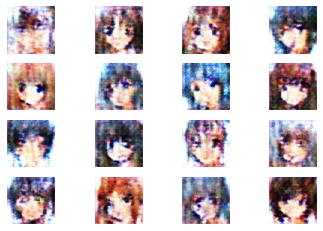



epoch -> [10/200], discriminator_loss = 185.22, generator_loss = 343.23



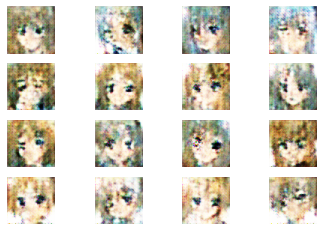



epoch -> [11/200], discriminator_loss = 185.89, generator_loss = 332.65



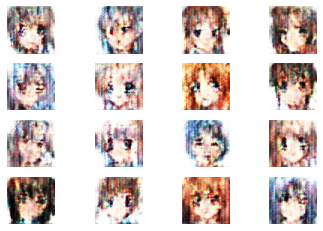



epoch -> [12/200], discriminator_loss = 182.30, generator_loss = 347.07



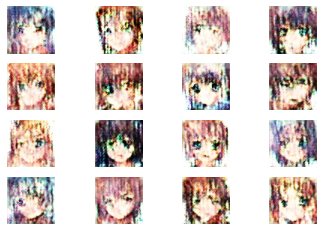



epoch -> [13/200], discriminator_loss = 183.37, generator_loss = 337.85



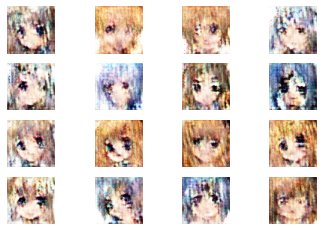



epoch -> [14/200], discriminator_loss = 187.72, generator_loss = 323.49



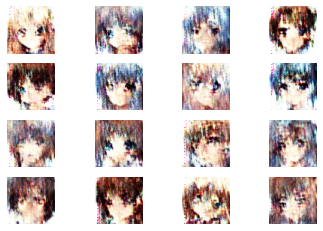



epoch -> [15/200], discriminator_loss = 192.52, generator_loss = 314.76



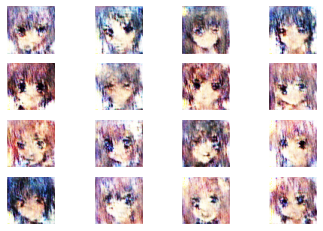



epoch -> [16/200], discriminator_loss = 187.91, generator_loss = 320.62



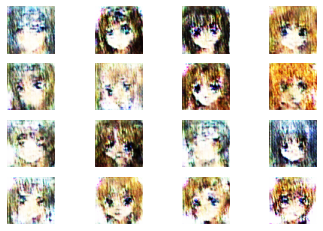



epoch -> [17/200], discriminator_loss = 192.78, generator_loss = 307.74



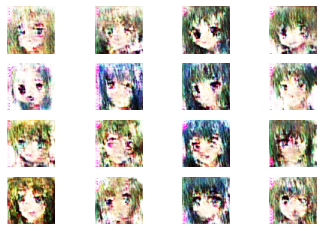



epoch -> [18/200], discriminator_loss = 187.77, generator_loss = 319.46



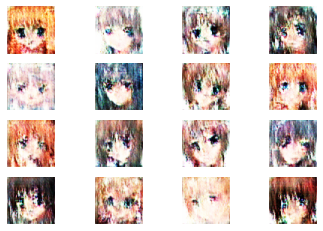



epoch -> [19/200], discriminator_loss = 188.57, generator_loss = 310.58



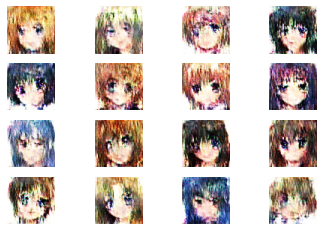



epoch -> [20/200], discriminator_loss = 187.41, generator_loss = 312.68



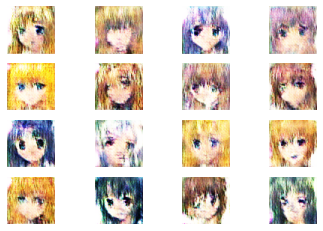



epoch -> [21/200], discriminator_loss = 182.51, generator_loss = 330.95



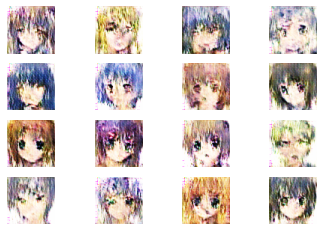



epoch -> [22/200], discriminator_loss = 183.41, generator_loss = 324.40



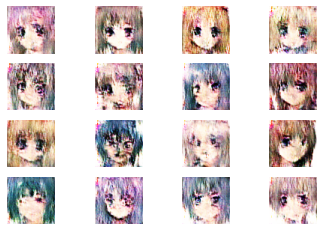



epoch -> [23/200], discriminator_loss = 184.99, generator_loss = 321.14



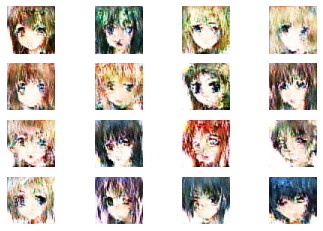



epoch -> [24/200], discriminator_loss = 181.07, generator_loss = 331.91



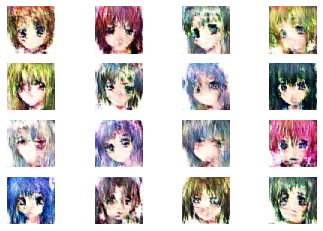



epoch -> [25/200], discriminator_loss = 183.00, generator_loss = 330.08



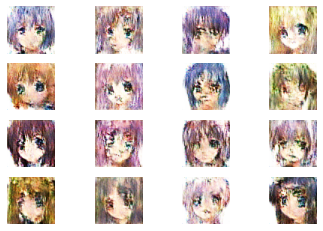



epoch -> [26/200], discriminator_loss = 179.32, generator_loss = 334.32



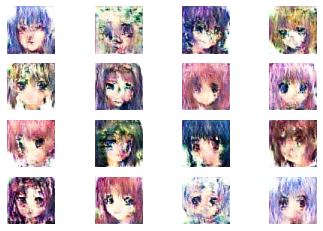



epoch -> [27/200], discriminator_loss = 177.93, generator_loss = 331.02



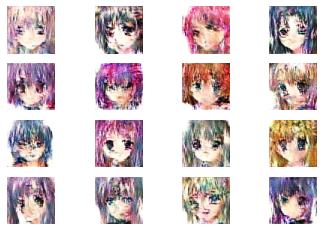



epoch -> [28/200], discriminator_loss = 168.10, generator_loss = 384.85



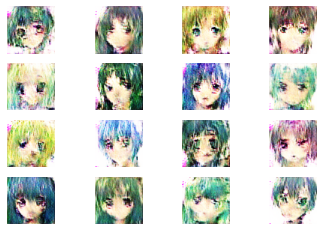



epoch -> [29/200], discriminator_loss = 169.01, generator_loss = 359.34



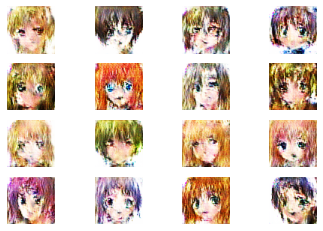



epoch -> [30/200], discriminator_loss = 168.61, generator_loss = 368.14



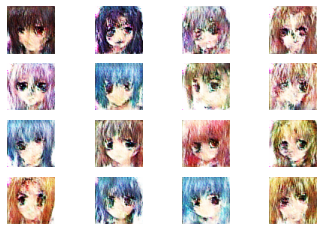



epoch -> [31/200], discriminator_loss = 170.22, generator_loss = 366.61



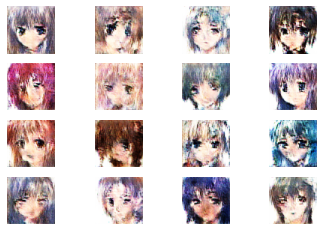



epoch -> [32/200], discriminator_loss = 166.79, generator_loss = 375.19



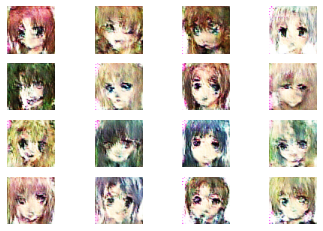



epoch -> [33/200], discriminator_loss = 167.06, generator_loss = 375.99



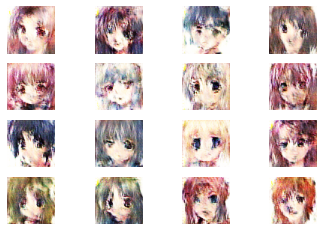



epoch -> [34/200], discriminator_loss = 165.35, generator_loss = 383.47



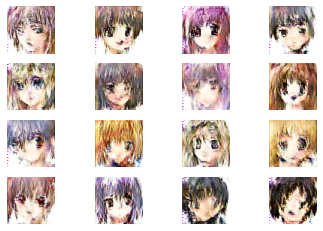



epoch -> [35/200], discriminator_loss = 162.69, generator_loss = 389.44



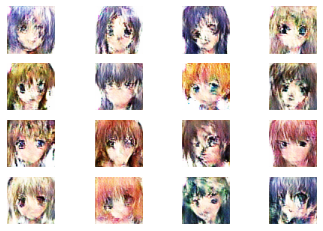



epoch -> [36/200], discriminator_loss = 152.54, generator_loss = 426.39



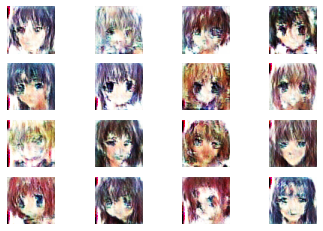



epoch -> [37/200], discriminator_loss = 155.25, generator_loss = 420.42



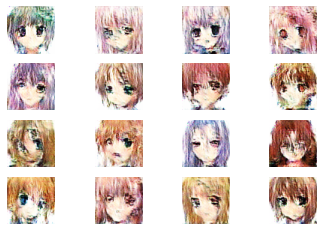



epoch -> [38/200], discriminator_loss = 153.90, generator_loss = 419.29



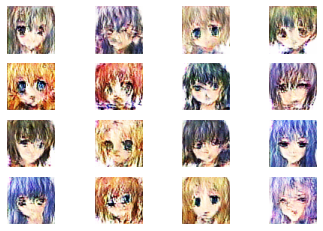



epoch -> [39/200], discriminator_loss = 151.20, generator_loss = 424.34



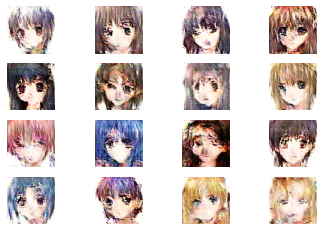



epoch -> [40/200], discriminator_loss = 149.69, generator_loss = 434.49



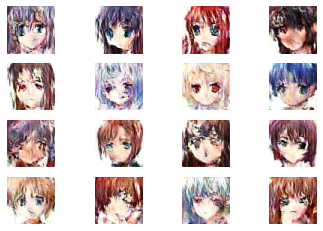



epoch -> [41/200], discriminator_loss = 147.76, generator_loss = 440.01



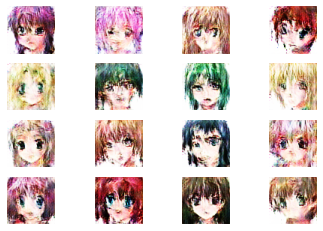



epoch -> [42/200], discriminator_loss = 145.43, generator_loss = 456.64



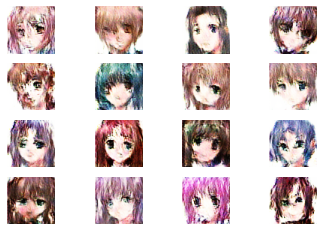



epoch -> [43/200], discriminator_loss = 142.71, generator_loss = 468.08



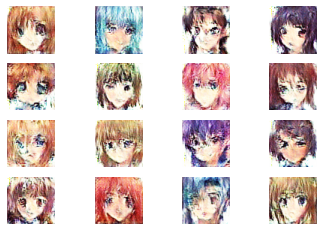



epoch -> [44/200], discriminator_loss = 138.21, generator_loss = 481.21



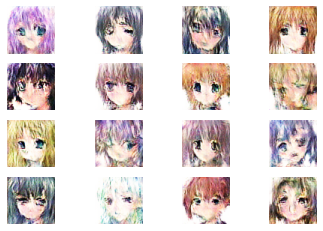



epoch -> [45/200], discriminator_loss = 134.76, generator_loss = 498.80



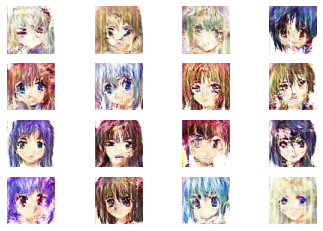



epoch -> [46/200], discriminator_loss = 134.75, generator_loss = 508.03



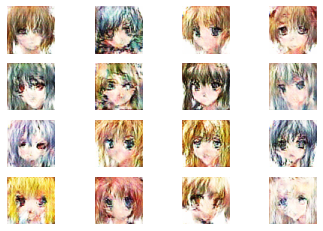



epoch -> [47/200], discriminator_loss = 129.19, generator_loss = 509.82



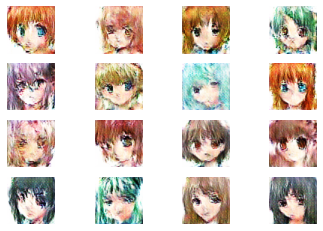



epoch -> [48/200], discriminator_loss = 129.51, generator_loss = 522.54



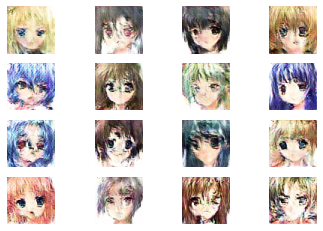



epoch -> [49/200], discriminator_loss = 122.79, generator_loss = 537.52



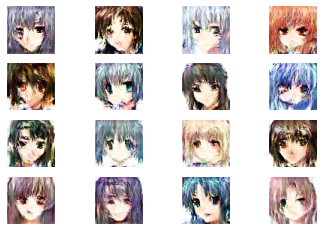



epoch -> [50/200], discriminator_loss = 124.36, generator_loss = 545.90



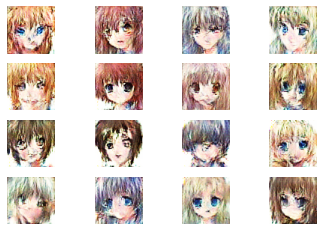



epoch -> [51/200], discriminator_loss = 123.63, generator_loss = 549.50



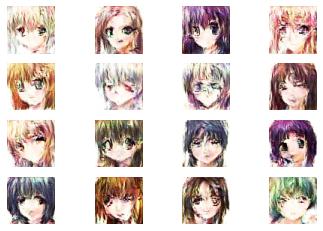



epoch -> [52/200], discriminator_loss = 118.88, generator_loss = 576.78



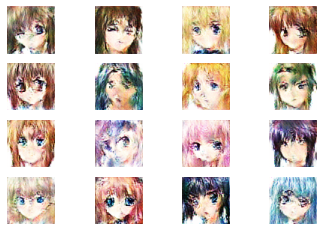



epoch -> [53/200], discriminator_loss = 113.53, generator_loss = 591.35



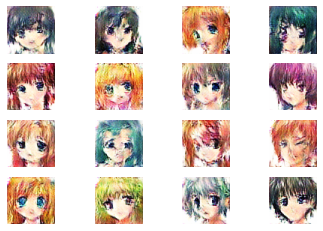



epoch -> [54/200], discriminator_loss = 113.54, generator_loss = 616.85



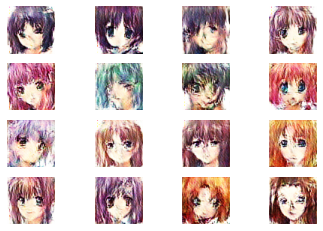



epoch -> [55/200], discriminator_loss = 112.72, generator_loss = 612.55



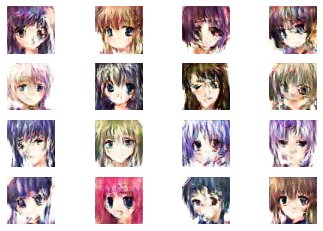



epoch -> [56/200], discriminator_loss = 106.92, generator_loss = 627.49



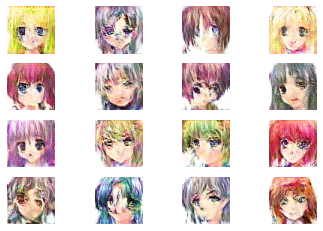



epoch -> [57/200], discriminator_loss = 107.34, generator_loss = 642.87



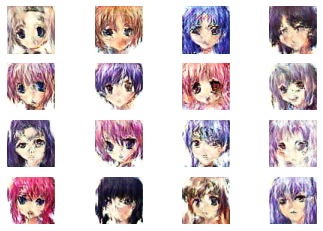



epoch -> [58/200], discriminator_loss = 103.89, generator_loss = 645.52



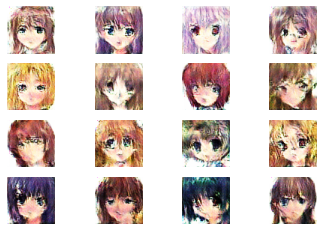



epoch -> [59/200], discriminator_loss = 101.20, generator_loss = 686.10



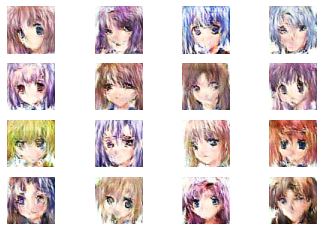



epoch -> [60/200], discriminator_loss = 96.35, generator_loss = 703.16



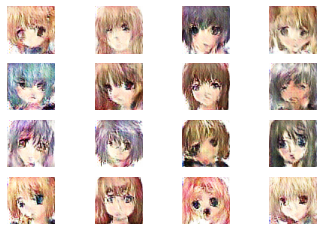



epoch -> [61/200], discriminator_loss = 98.03, generator_loss = 703.32



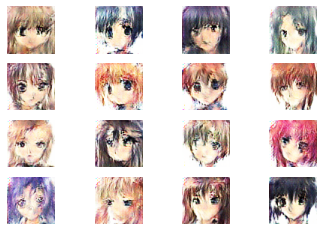



epoch -> [62/200], discriminator_loss = 96.37, generator_loss = 722.65



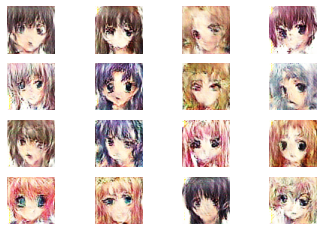



epoch -> [63/200], discriminator_loss = 97.55, generator_loss = 727.67



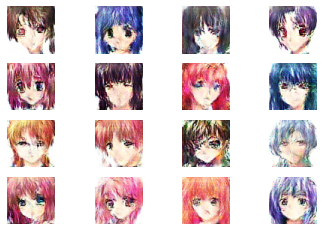



epoch -> [64/200], discriminator_loss = 92.22, generator_loss = 762.16



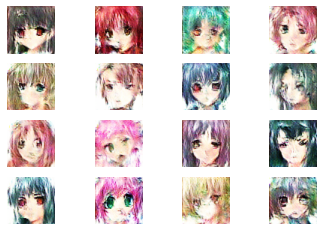



epoch -> [65/200], discriminator_loss = 90.31, generator_loss = 752.74



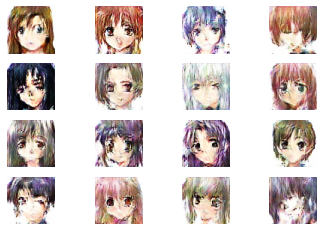



epoch -> [66/200], discriminator_loss = 87.91, generator_loss = 774.94



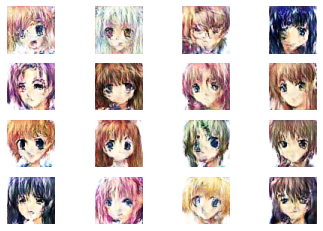



epoch -> [67/200], discriminator_loss = 84.48, generator_loss = 790.53



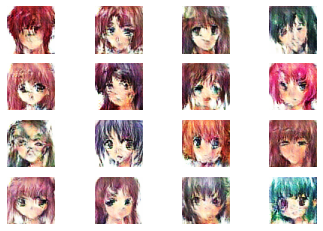



epoch -> [68/200], discriminator_loss = 84.73, generator_loss = 822.26



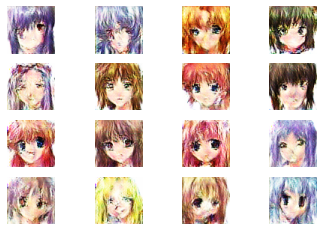



epoch -> [69/200], discriminator_loss = 84.78, generator_loss = 803.69



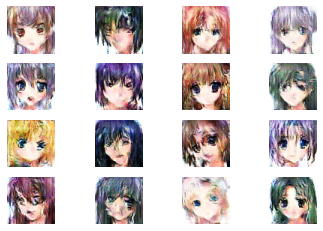



epoch -> [70/200], discriminator_loss = 77.41, generator_loss = 856.03



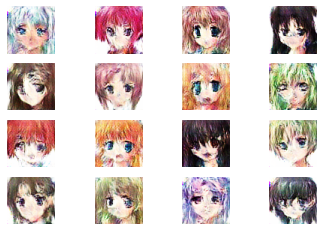



epoch -> [71/200], discriminator_loss = 82.57, generator_loss = 842.34



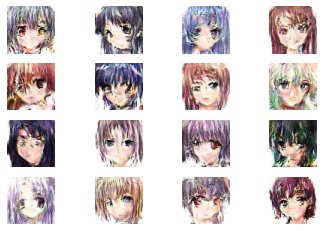



epoch -> [72/200], discriminator_loss = 84.09, generator_loss = 856.06



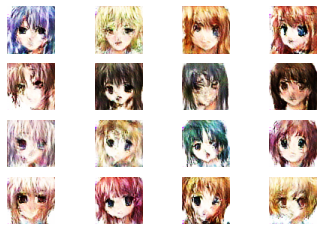



epoch -> [73/200], discriminator_loss = 80.93, generator_loss = 863.57



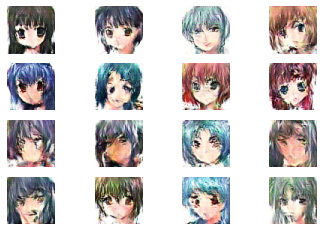



epoch -> [74/200], discriminator_loss = 75.78, generator_loss = 872.86



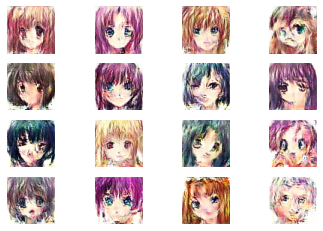



epoch -> [75/200], discriminator_loss = 77.33, generator_loss = 883.79



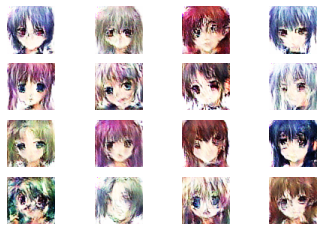



epoch -> [76/200], discriminator_loss = 76.84, generator_loss = 899.70



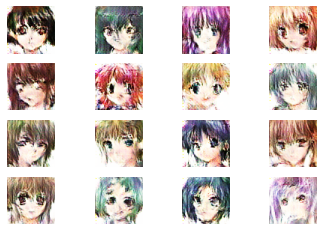



epoch -> [77/200], discriminator_loss = 72.68, generator_loss = 917.98



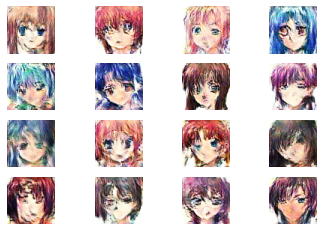



epoch -> [78/200], discriminator_loss = 75.68, generator_loss = 924.68



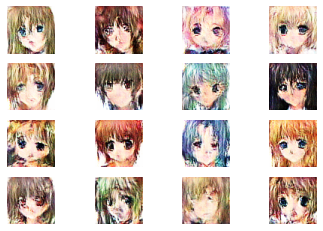



epoch -> [79/200], discriminator_loss = 71.65, generator_loss = 969.39



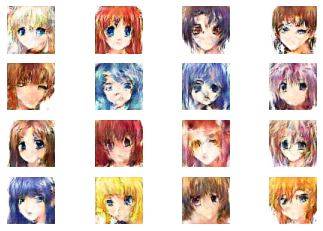



epoch -> [80/200], discriminator_loss = 73.87, generator_loss = 968.10



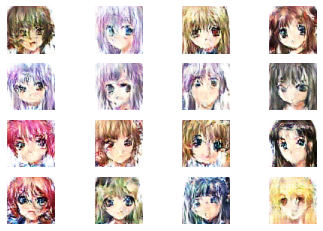



epoch -> [81/200], discriminator_loss = 68.64, generator_loss = 1000.39



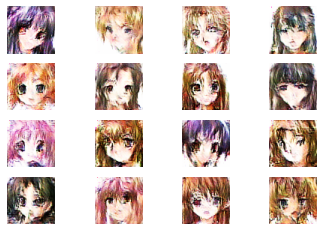



epoch -> [82/200], discriminator_loss = 69.65, generator_loss = 976.64



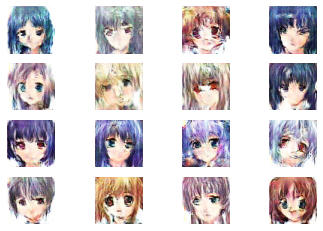



epoch -> [83/200], discriminator_loss = 68.74, generator_loss = 982.93



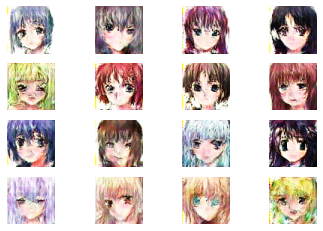



epoch -> [84/200], discriminator_loss = 68.48, generator_loss = 991.43



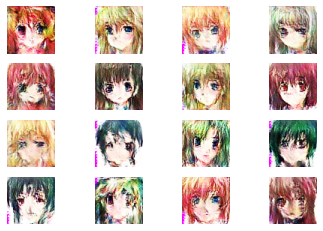



epoch -> [85/200], discriminator_loss = 68.70, generator_loss = 1008.29



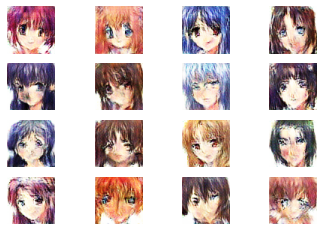



epoch -> [86/200], discriminator_loss = 65.20, generator_loss = 1032.01



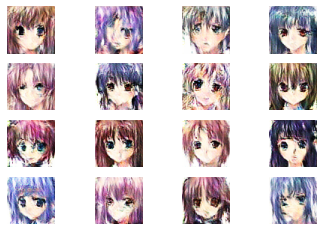



epoch -> [87/200], discriminator_loss = 66.73, generator_loss = 1032.86



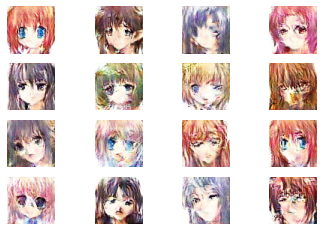



epoch -> [88/200], discriminator_loss = 67.87, generator_loss = 1044.44



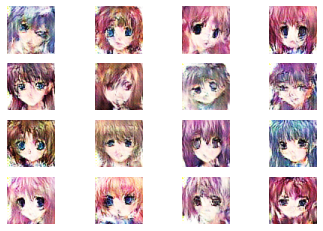



epoch -> [89/200], discriminator_loss = 61.65, generator_loss = 1054.24



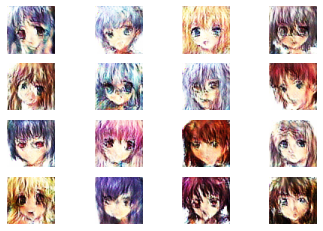



epoch -> [90/200], discriminator_loss = 61.43, generator_loss = 1056.85



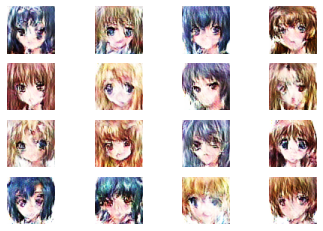



epoch -> [91/200], discriminator_loss = 60.33, generator_loss = 1090.21



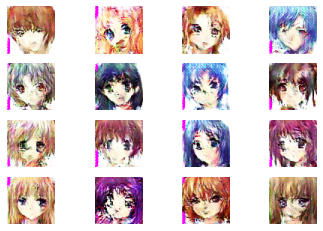



epoch -> [92/200], discriminator_loss = 59.35, generator_loss = 1089.52



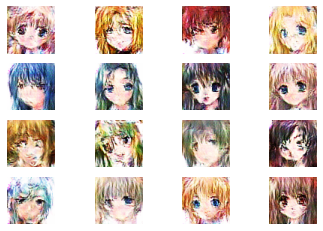



epoch -> [93/200], discriminator_loss = 61.68, generator_loss = 1091.46



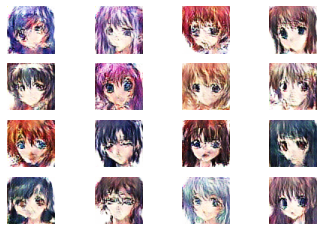



epoch -> [94/200], discriminator_loss = 60.51, generator_loss = 1118.31



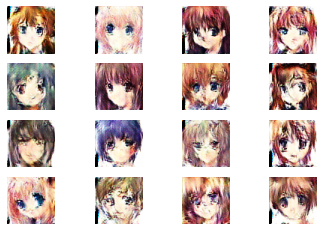



epoch -> [95/200], discriminator_loss = 57.29, generator_loss = 1131.48



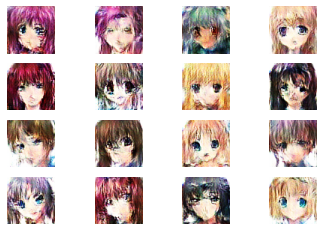



epoch -> [96/200], discriminator_loss = 54.14, generator_loss = 1140.14



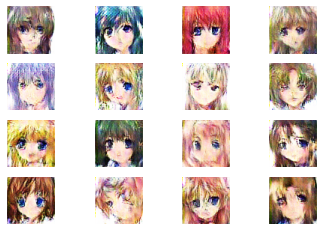



epoch -> [97/200], discriminator_loss = 58.48, generator_loss = 1142.93



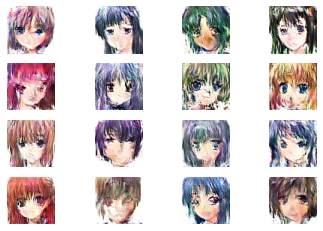



epoch -> [98/200], discriminator_loss = 58.80, generator_loss = 1140.69



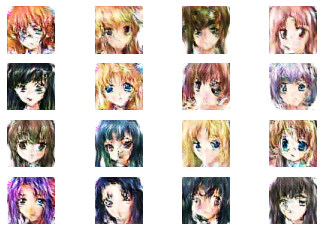



epoch -> [99/200], discriminator_loss = 55.89, generator_loss = 1175.12



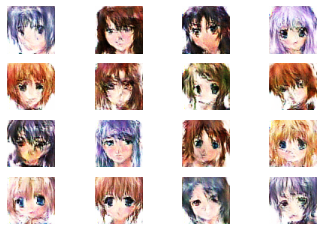



epoch -> [100/200], discriminator_loss = 56.98, generator_loss = 1138.51



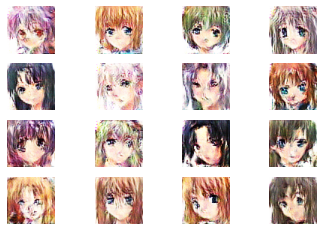



epoch -> [101/200], discriminator_loss = 55.77, generator_loss = 1161.92



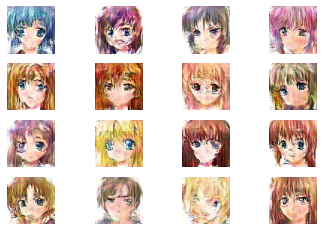



epoch -> [102/200], discriminator_loss = 55.53, generator_loss = 1183.77



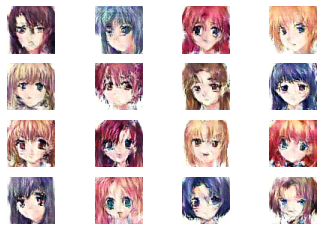



epoch -> [103/200], discriminator_loss = 54.86, generator_loss = 1188.10



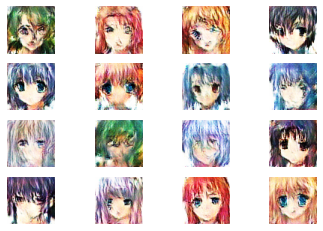



epoch -> [104/200], discriminator_loss = 54.59, generator_loss = 1177.70



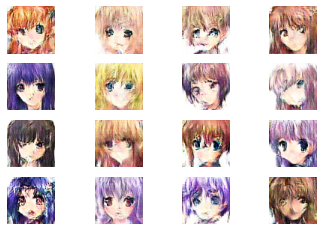



epoch -> [105/200], discriminator_loss = 56.57, generator_loss = 1200.61



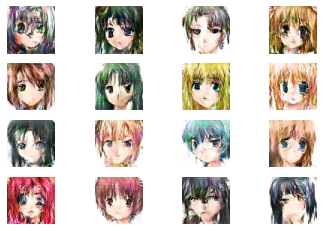



epoch -> [106/200], discriminator_loss = 51.92, generator_loss = 1200.47



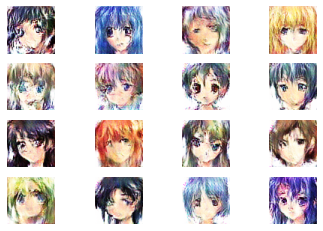



epoch -> [107/200], discriminator_loss = 49.68, generator_loss = 1229.24



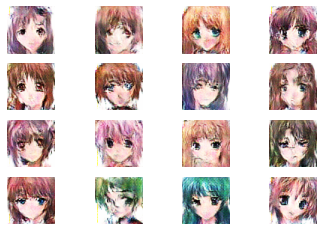



epoch -> [108/200], discriminator_loss = 55.11, generator_loss = 1217.29



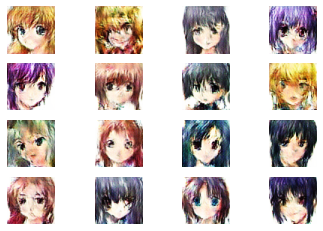



epoch -> [109/200], discriminator_loss = 48.61, generator_loss = 1236.62



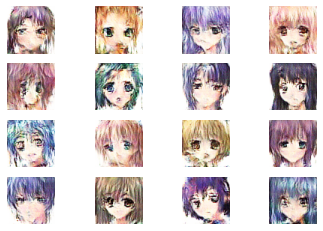



epoch -> [110/200], discriminator_loss = 50.34, generator_loss = 1272.57



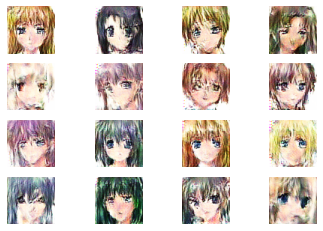



epoch -> [111/200], discriminator_loss = 50.24, generator_loss = 1259.27



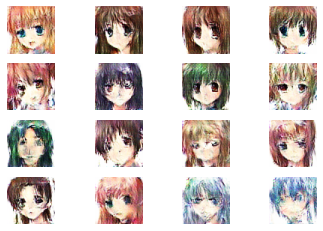



epoch -> [112/200], discriminator_loss = 47.46, generator_loss = 1279.88



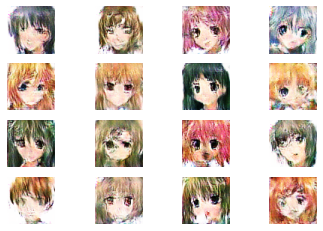



epoch -> [113/200], discriminator_loss = 49.59, generator_loss = 1296.20



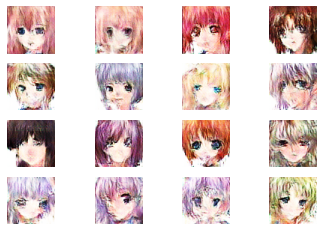



epoch -> [114/200], discriminator_loss = 47.53, generator_loss = 1314.53



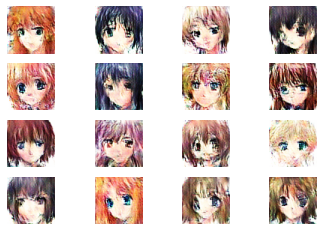



epoch -> [115/200], discriminator_loss = 49.40, generator_loss = 1285.17



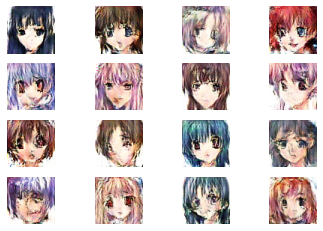



epoch -> [116/200], discriminator_loss = 49.74, generator_loss = 1289.73



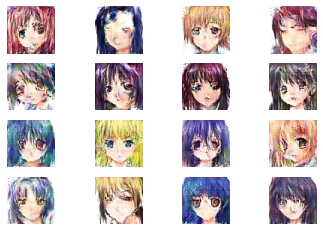



epoch -> [117/200], discriminator_loss = 45.63, generator_loss = 1315.58



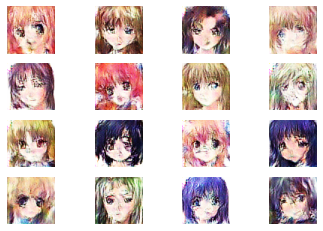



epoch -> [118/200], discriminator_loss = 48.04, generator_loss = 1292.75



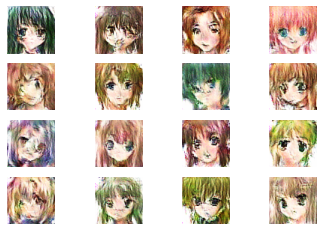



epoch -> [119/200], discriminator_loss = 44.73, generator_loss = 1339.03



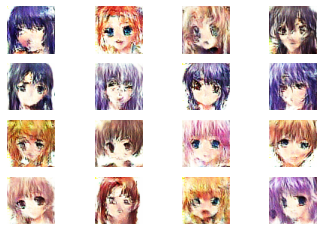



epoch -> [120/200], discriminator_loss = 46.48, generator_loss = 1342.53



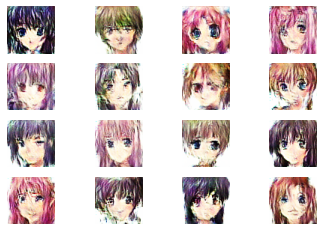



epoch -> [121/200], discriminator_loss = 46.70, generator_loss = 1334.46



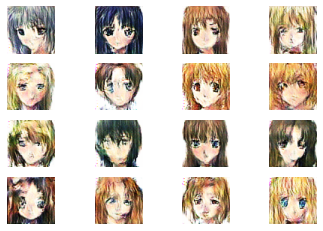



epoch -> [122/200], discriminator_loss = 45.57, generator_loss = 1329.72



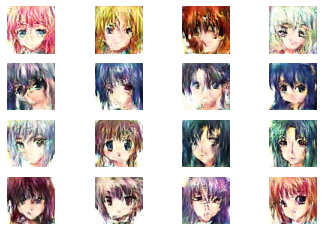



epoch -> [123/200], discriminator_loss = 44.02, generator_loss = 1370.88



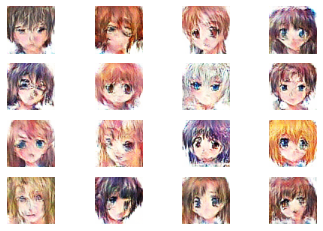



epoch -> [124/200], discriminator_loss = 45.48, generator_loss = 1386.44



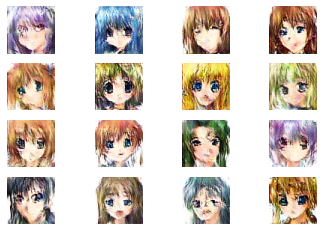



epoch -> [125/200], discriminator_loss = 47.42, generator_loss = 1405.48



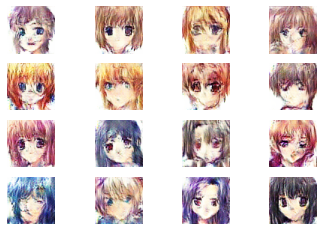



epoch -> [126/200], discriminator_loss = 45.63, generator_loss = 1382.03



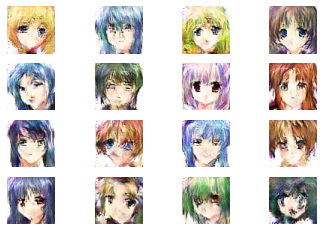



epoch -> [127/200], discriminator_loss = 42.98, generator_loss = 1414.37



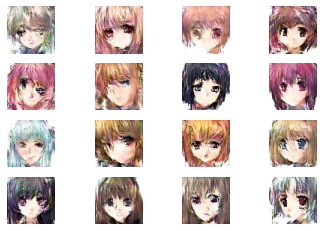



epoch -> [128/200], discriminator_loss = 43.52, generator_loss = 1379.75



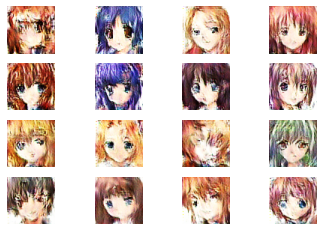



epoch -> [129/200], discriminator_loss = 45.26, generator_loss = 1389.74



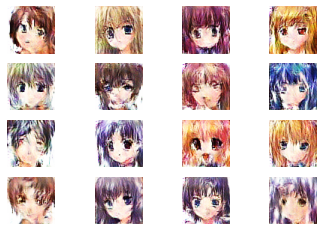



epoch -> [130/200], discriminator_loss = 45.39, generator_loss = 1398.00



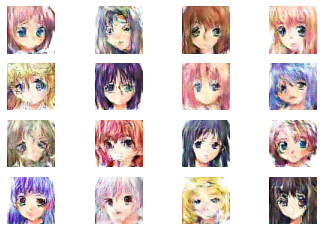



epoch -> [131/200], discriminator_loss = 43.91, generator_loss = 1389.55



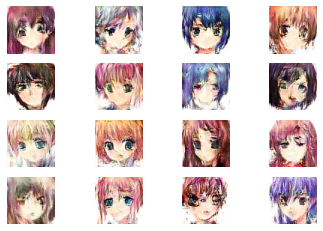



epoch -> [132/200], discriminator_loss = 41.75, generator_loss = 1413.00



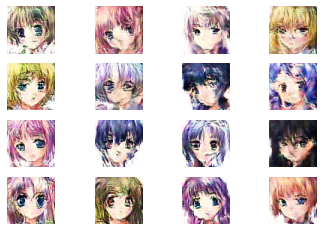



epoch -> [133/200], discriminator_loss = 44.34, generator_loss = 1451.21



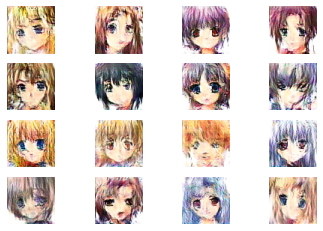



epoch -> [134/200], discriminator_loss = 43.07, generator_loss = 1421.66



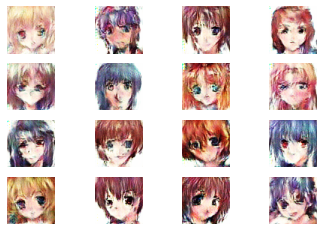



epoch -> [135/200], discriminator_loss = 41.15, generator_loss = 1414.61



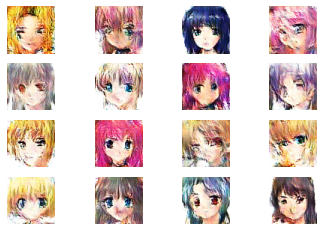



epoch -> [136/200], discriminator_loss = 40.20, generator_loss = 1466.14



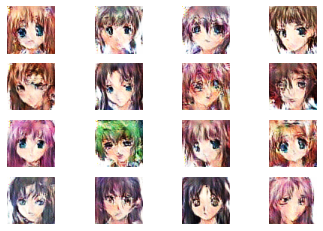



epoch -> [137/200], discriminator_loss = 37.71, generator_loss = 1465.38



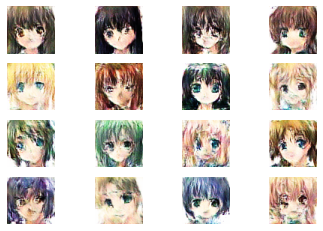



epoch -> [138/200], discriminator_loss = 39.63, generator_loss = 1497.72



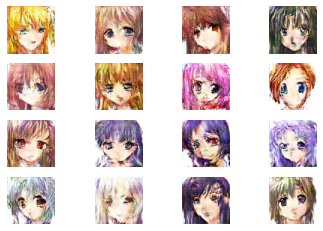



epoch -> [139/200], discriminator_loss = 41.95, generator_loss = 1469.33



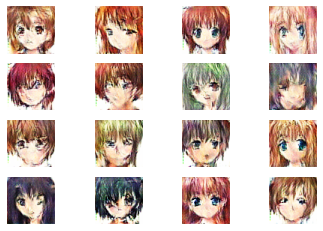



epoch -> [140/200], discriminator_loss = 34.48, generator_loss = 1486.57



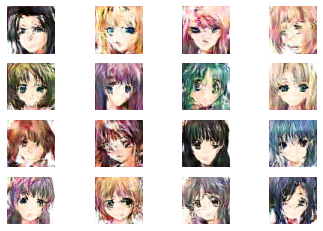



epoch -> [141/200], discriminator_loss = 40.23, generator_loss = 1492.78



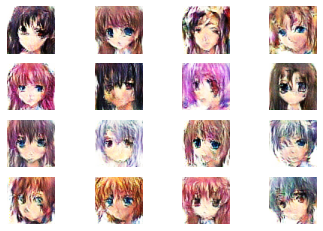



epoch -> [142/200], discriminator_loss = 43.77, generator_loss = 1475.65



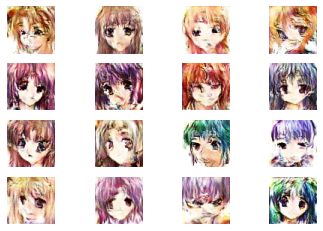



epoch -> [143/200], discriminator_loss = 37.73, generator_loss = 1500.40



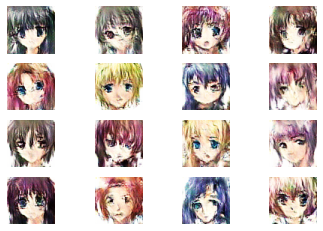



epoch -> [144/200], discriminator_loss = 37.01, generator_loss = 1504.53



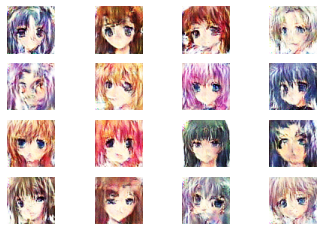



epoch -> [145/200], discriminator_loss = 38.37, generator_loss = 1500.48



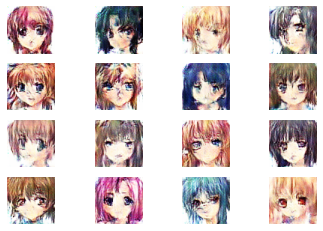



epoch -> [146/200], discriminator_loss = 38.22, generator_loss = 1533.28



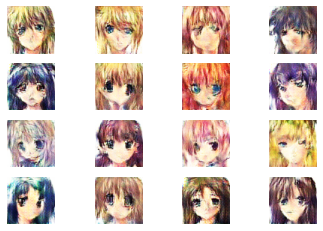



epoch -> [147/200], discriminator_loss = 39.06, generator_loss = 1492.88



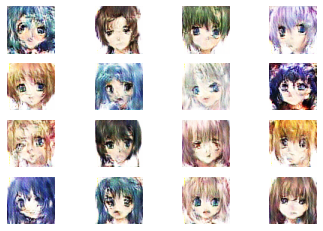



epoch -> [148/200], discriminator_loss = 35.11, generator_loss = 1534.64



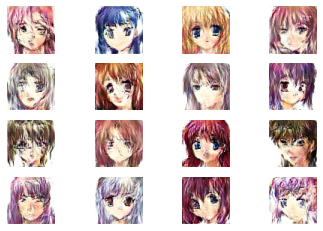



epoch -> [149/200], discriminator_loss = 36.17, generator_loss = 1547.76



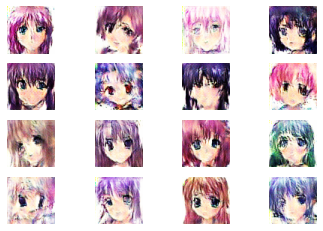



epoch -> [150/200], discriminator_loss = 40.39, generator_loss = 1535.16



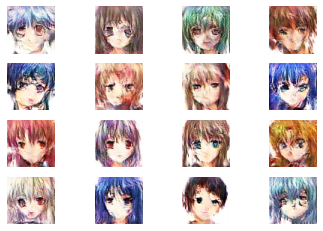



epoch -> [151/200], discriminator_loss = 38.74, generator_loss = 1537.91



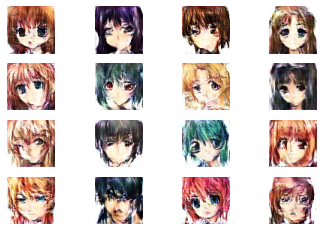



epoch -> [152/200], discriminator_loss = 34.14, generator_loss = 1531.63



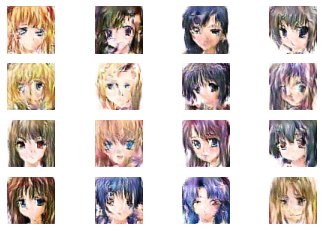



epoch -> [153/200], discriminator_loss = 35.60, generator_loss = 1563.86



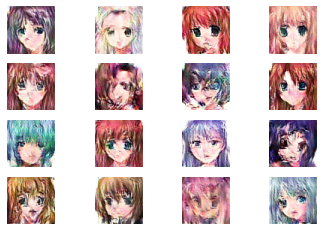



epoch -> [154/200], discriminator_loss = 34.47, generator_loss = 1549.74



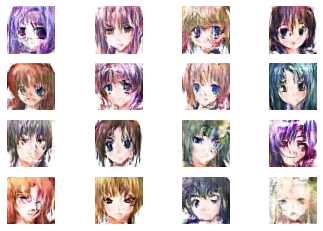



epoch -> [155/200], discriminator_loss = 34.05, generator_loss = 1582.80



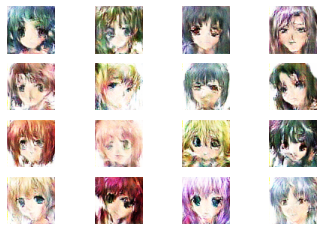



epoch -> [156/200], discriminator_loss = 35.55, generator_loss = 1575.23



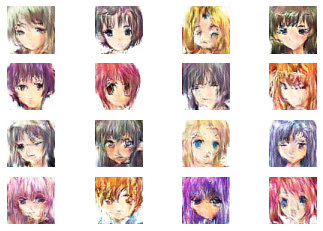



epoch -> [157/200], discriminator_loss = 33.79, generator_loss = 1610.67



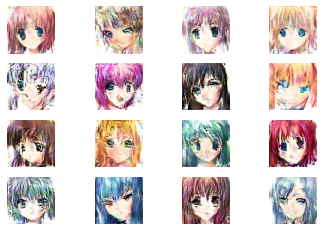



epoch -> [158/200], discriminator_loss = 39.51, generator_loss = 1602.00



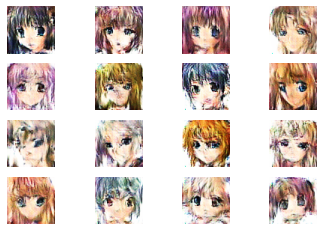



epoch -> [159/200], discriminator_loss = 33.70, generator_loss = 1600.37



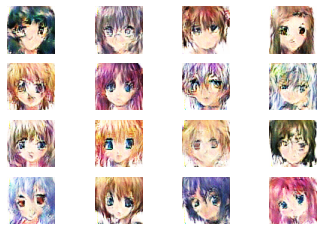



epoch -> [160/200], discriminator_loss = 35.42, generator_loss = 1594.10



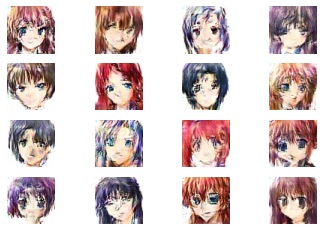



epoch -> [161/200], discriminator_loss = 37.44, generator_loss = 1577.33



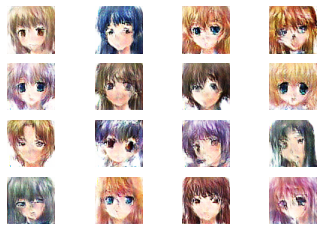



epoch -> [162/200], discriminator_loss = 31.85, generator_loss = 1657.08



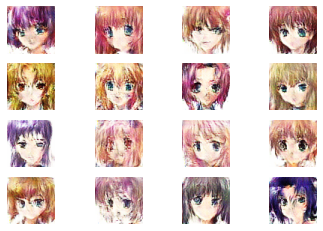



epoch -> [163/200], discriminator_loss = 33.47, generator_loss = 1588.80



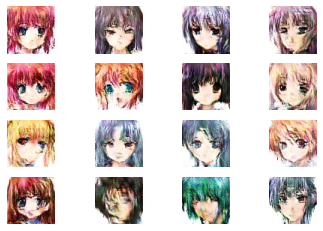



epoch -> [164/200], discriminator_loss = 31.99, generator_loss = 1615.54



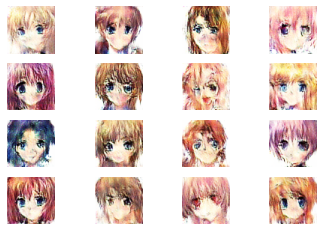



epoch -> [165/200], discriminator_loss = 33.32, generator_loss = 1683.57



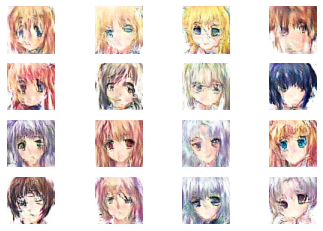



epoch -> [166/200], discriminator_loss = 33.99, generator_loss = 1598.62



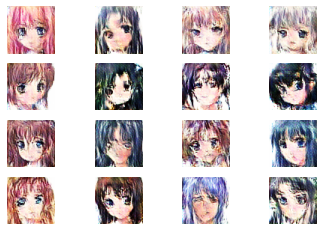



epoch -> [167/200], discriminator_loss = 33.35, generator_loss = 1671.85



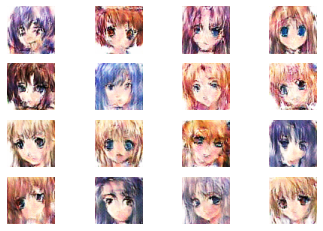



epoch -> [168/200], discriminator_loss = 33.79, generator_loss = 1662.78



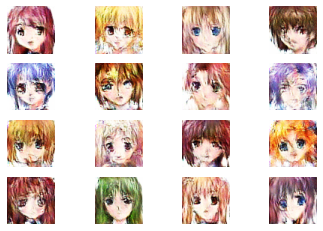



epoch -> [169/200], discriminator_loss = 33.79, generator_loss = 1663.40



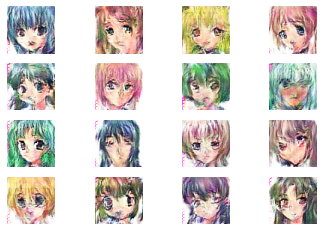



epoch -> [170/200], discriminator_loss = 33.57, generator_loss = 1673.22



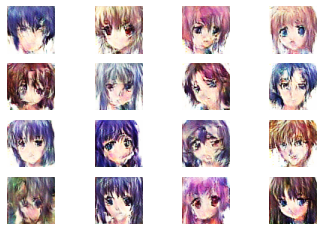



epoch -> [171/200], discriminator_loss = 35.34, generator_loss = 1657.45



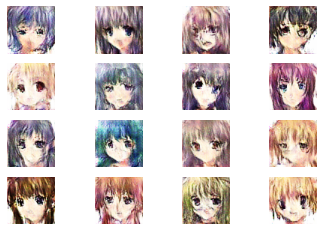



epoch -> [172/200], discriminator_loss = 35.20, generator_loss = 1615.76



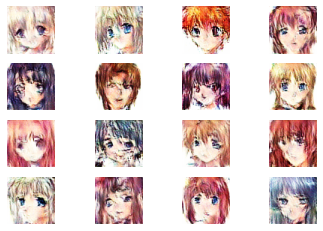



epoch -> [173/200], discriminator_loss = 32.99, generator_loss = 1658.90



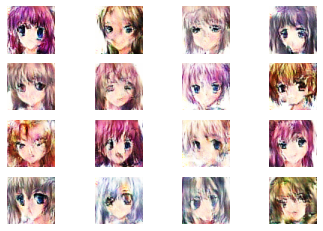



epoch -> [174/200], discriminator_loss = 30.84, generator_loss = 1639.35



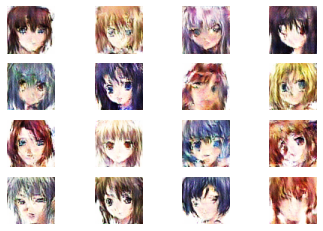



epoch -> [175/200], discriminator_loss = 33.24, generator_loss = 1639.98



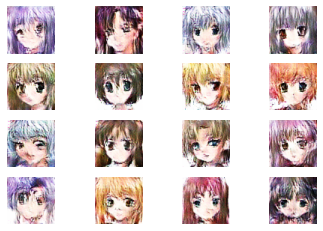



epoch -> [176/200], discriminator_loss = 31.81, generator_loss = 1682.15



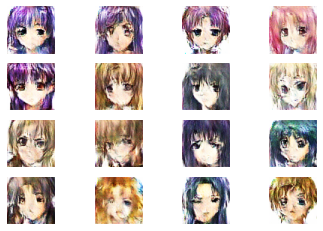



epoch -> [177/200], discriminator_loss = 34.64, generator_loss = 1668.98



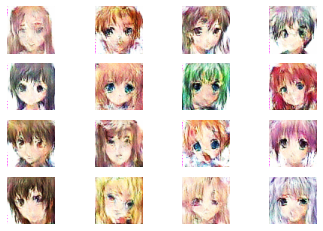



epoch -> [178/200], discriminator_loss = 34.29, generator_loss = 1733.65



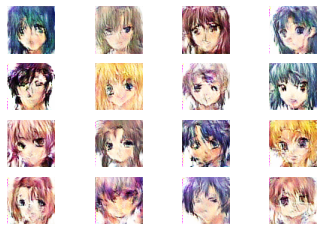



epoch -> [179/200], discriminator_loss = 30.27, generator_loss = 1676.91



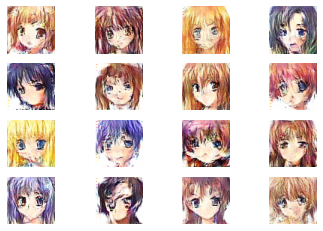



epoch -> [180/200], discriminator_loss = 33.12, generator_loss = 1707.67



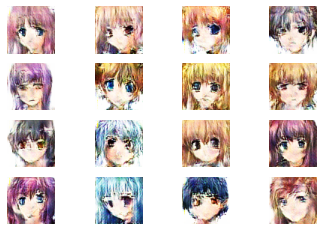



epoch -> [181/200], discriminator_loss = 32.81, generator_loss = 1680.51



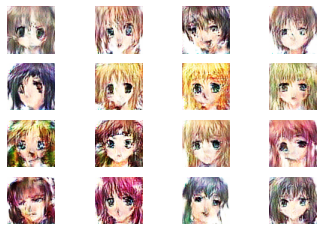



epoch -> [182/200], discriminator_loss = 35.34, generator_loss = 1670.27



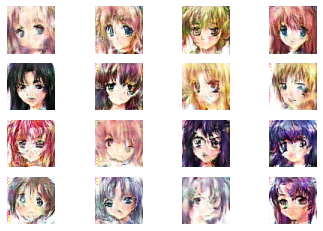



epoch -> [183/200], discriminator_loss = 31.31, generator_loss = 1693.52



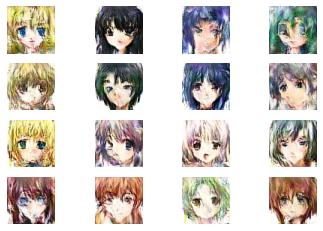



epoch -> [184/200], discriminator_loss = 31.35, generator_loss = 1714.32



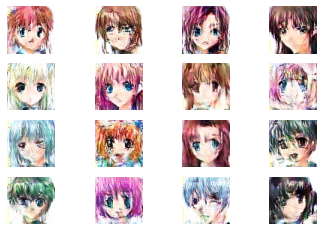



epoch -> [185/200], discriminator_loss = 29.85, generator_loss = 1702.04



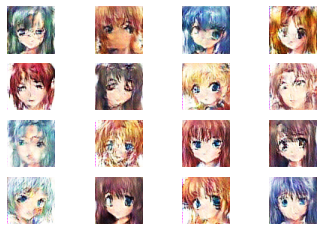



epoch -> [186/200], discriminator_loss = 29.17, generator_loss = 1704.14



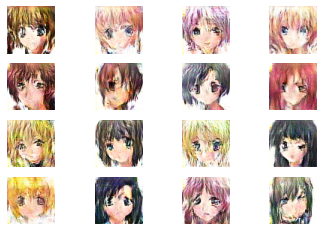



epoch -> [187/200], discriminator_loss = 28.21, generator_loss = 1704.05



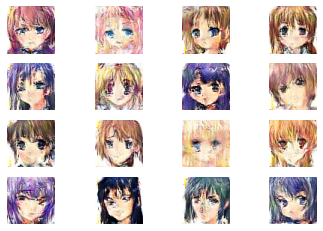



epoch -> [188/200], discriminator_loss = 31.94, generator_loss = 1777.00



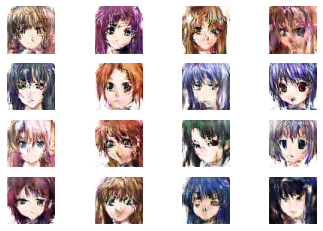



epoch -> [189/200], discriminator_loss = 30.75, generator_loss = 1731.22



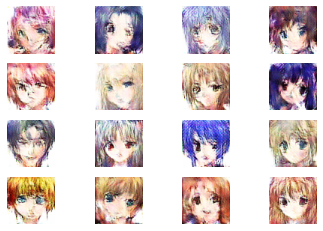



epoch -> [190/200], discriminator_loss = 31.63, generator_loss = 1723.37



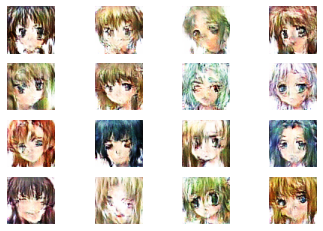



epoch -> [191/200], discriminator_loss = 33.03, generator_loss = 1763.37



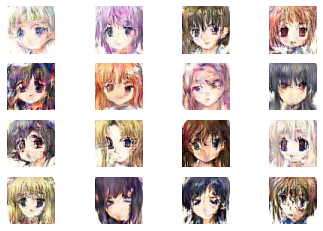



epoch -> [192/200], discriminator_loss = 30.70, generator_loss = 1785.87



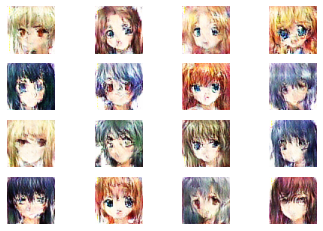



epoch -> [193/200], discriminator_loss = 27.00, generator_loss = 1729.57



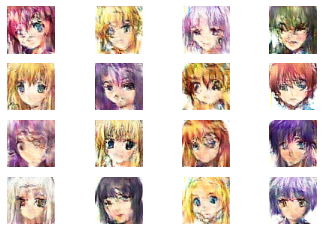



epoch -> [194/200], discriminator_loss = 28.29, generator_loss = 1737.39



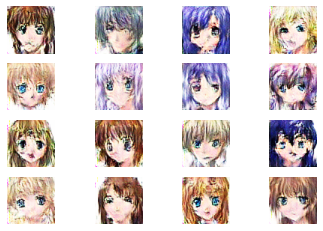



epoch -> [195/200], discriminator_loss = 30.16, generator_loss = 1766.76



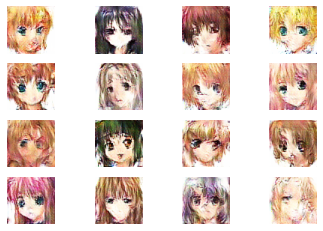



epoch -> [196/200], discriminator_loss = 29.93, generator_loss = 1709.39



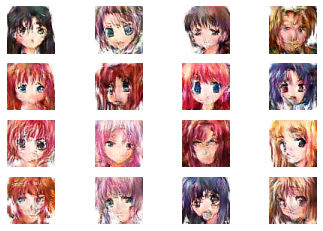



epoch -> [197/200], discriminator_loss = 28.81, generator_loss = 1761.33



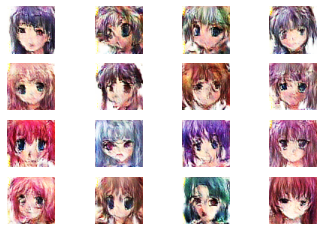



epoch -> [198/200], discriminator_loss = 28.73, generator_loss = 1771.04



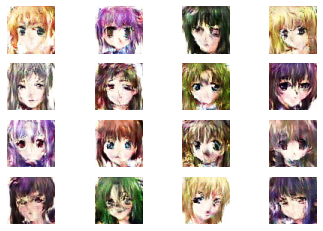



epoch -> [199/200], discriminator_loss = 27.27, generator_loss = 1751.54



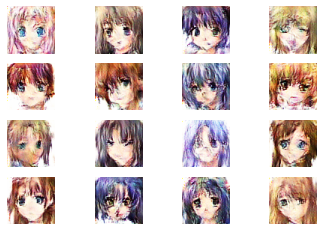



epoch -> [200/200], discriminator_loss = 29.53, generator_loss = 1795.44



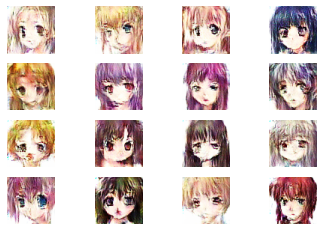

In [56]:
with tf.device(device_name):

  latent_dim = 512
  n_epochs = 200
  n_batch = 32
  d_model = define_discriminator()
  g_model = define_generator(latent_dim)
  gan_model = define_gan(g_model, d_model)
  dataset = load_real_samples()
  print('\nREADY TO GO !!!\n')
  
  d_loss, g_loss = train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs, n_batch)

## Plot Loss Values

In [57]:
loaded = np.load('/content/drive/MyDrive/Animo/DataSet1/loss_record_11.npz')
print(loaded['a'].shape)
print(loaded['b'].shape)

(200,)
(200,)


In [58]:
import matplotlib.pyplot as plot

d_loss = np.array(loaded['a'])
g_loss = np.array(loaded['b'])

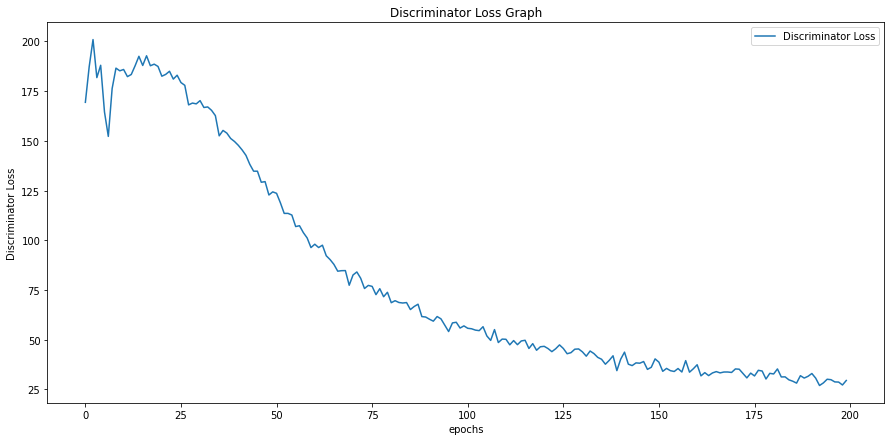

In [59]:
plt.figure(figsize=(15,7))
plt.plot(d_loss)
plt.title('Discriminator Loss Graph')
plt.ylabel('Discriminator Loss')
plt.xlabel('epochs')
plt.legend(["Discriminator Loss"], loc='upper right')
plt.show()

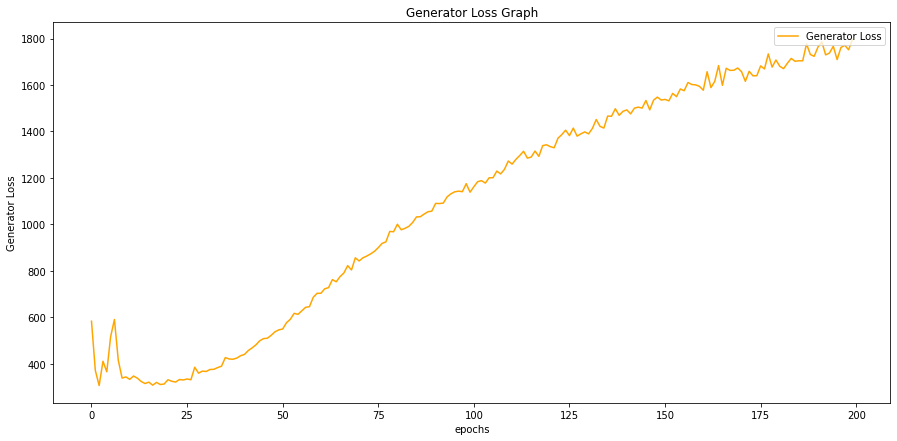

In [60]:
plt.figure(figsize=(15,7))
plt.plot(g_loss,color='orange')
plt.title('Generator Loss Graph')
plt.ylabel('Generator Loss')
plt.xlabel('epochs')
plt.legend(["Generator Loss"], loc='upper right')
plt.show()

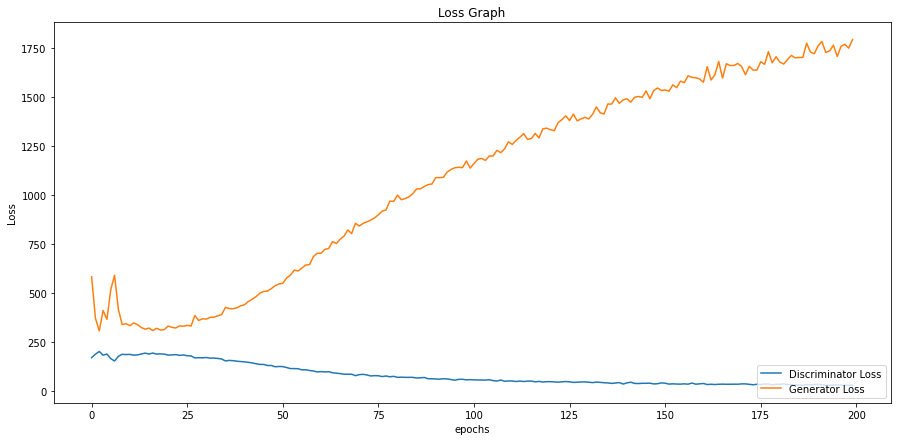

In [61]:
plt.figure(figsize=(15,7))
plt.plot(d_loss)
plt.plot(g_loss)
plt.title('Loss Graph')
plt.ylabel('Loss')
plt.xlabel('epochs')
plt.legend(["Discriminator Loss", "Generator Loss"], loc='lower right')
plt.show()

# Prediction

latent points(latent points):  (36, 512)

Generated images with labels:  (36, 64, 64, 3) 



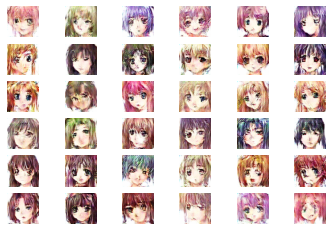

In [64]:
latent_dim = 512
n_samples = 36
z_input= generate_latent_points(latent_dim, n_samples)
print("latent points(latent points): ",z_input.shape)
data = z_input
g_model = tensorflow.keras.models.load_model("/content/drive/MyDrive/Animo/DataSet1/generator_model_11.h5")
pred = g_model.predict(data)
pred = (pred +1 ) / 2.0
print("\nGenerated images with labels: ",pred.shape,'\n')
save_plot(pred,n=6)

                                              -:END:-